## Notebook imports

In [2]:
from sklearn.datasets import load_boston
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import seaborn as sns

%matplotlib inline

## gathering data

In [3]:
boston_dataset = load_boston()
boston_dataset

{'data': array([[6.3200e-03, 1.8000e+01, 2.3100e+00, ..., 1.5300e+01, 3.9690e+02,
         4.9800e+00],
        [2.7310e-02, 0.0000e+00, 7.0700e+00, ..., 1.7800e+01, 3.9690e+02,
         9.1400e+00],
        [2.7290e-02, 0.0000e+00, 7.0700e+00, ..., 1.7800e+01, 3.9283e+02,
         4.0300e+00],
        ...,
        [6.0760e-02, 0.0000e+00, 1.1930e+01, ..., 2.1000e+01, 3.9690e+02,
         5.6400e+00],
        [1.0959e-01, 0.0000e+00, 1.1930e+01, ..., 2.1000e+01, 3.9345e+02,
         6.4800e+00],
        [4.7410e-02, 0.0000e+00, 1.1930e+01, ..., 2.1000e+01, 3.9690e+02,
         7.8800e+00]]),
 'target': array([24. , 21.6, 34.7, 33.4, 36.2, 28.7, 22.9, 27.1, 16.5, 18.9, 15. ,
        18.9, 21.7, 20.4, 18.2, 19.9, 23.1, 17.5, 20.2, 18.2, 13.6, 19.6,
        15.2, 14.5, 15.6, 13.9, 16.6, 14.8, 18.4, 21. , 12.7, 14.5, 13.2,
        13.1, 13.5, 18.9, 20. , 21. , 24.7, 30.8, 34.9, 26.6, 25.3, 24.7,
        21.2, 19.3, 20. , 16.6, 14.4, 19.4, 19.7, 20.5, 25. , 23.4, 18.9,
        35.4, 24.7, 3

In [4]:
dir(boston_dataset)  # showing list of attribute

['DESCR', 'data', 'feature_names', 'filename', 'target']

In [5]:
print(boston_dataset. DESCR)  # describtion atrribute

.. _boston_dataset:

Boston house prices dataset
---------------------------

**Data Set Characteristics:**  

    :Number of Instances: 506 

    :Number of Attributes: 13 numeric/categorical predictive. Median Value (attribute 14) is usually the target.

    :Attribute Information (in order):
        - CRIM     per capita crime rate by town
        - ZN       proportion of residential land zoned for lots over 25,000 sq.ft.
        - INDUS    proportion of non-retail business acres per town
        - CHAS     Charles River dummy variable (= 1 if tract bounds river; 0 otherwise)
        - NOX      nitric oxides concentration (parts per 10 million)
        - RM       average number of rooms per dwelling
        - AGE      proportion of owner-occupied units built prior to 1940
        - DIS      weighted distances to five Boston employment centres
        - RAD      index of accessibility to radial highways
        - TAX      full-value property-tax rate per $10,000
        - PTRATIO  pu

In [6]:
# source of data: ok
# description of the data set: ok
# number of data point: 506
# number of features: 13
# names of features: in this dataset called 'attribute'
# description of the feature: after attribute name

In [7]:
print(boston_dataset.data.shape)
print(boston_dataset.feature_names)  # feature is independent variable
print(boston_dataset.target)  # the target is dependent variable

(506, 13)
['CRIM' 'ZN' 'INDUS' 'CHAS' 'NOX' 'RM' 'AGE' 'DIS' 'RAD' 'TAX' 'PTRATIO'
 'B' 'LSTAT']
[24.  21.6 34.7 33.4 36.2 28.7 22.9 27.1 16.5 18.9 15.  18.9 21.7 20.4
 18.2 19.9 23.1 17.5 20.2 18.2 13.6 19.6 15.2 14.5 15.6 13.9 16.6 14.8
 18.4 21.  12.7 14.5 13.2 13.1 13.5 18.9 20.  21.  24.7 30.8 34.9 26.6
 25.3 24.7 21.2 19.3 20.  16.6 14.4 19.4 19.7 20.5 25.  23.4 18.9 35.4
 24.7 31.6 23.3 19.6 18.7 16.  22.2 25.  33.  23.5 19.4 22.  17.4 20.9
 24.2 21.7 22.8 23.4 24.1 21.4 20.  20.8 21.2 20.3 28.  23.9 24.8 22.9
 23.9 26.6 22.5 22.2 23.6 28.7 22.6 22.  22.9 25.  20.6 28.4 21.4 38.7
 43.8 33.2 27.5 26.5 18.6 19.3 20.1 19.5 19.5 20.4 19.8 19.4 21.7 22.8
 18.8 18.7 18.5 18.3 21.2 19.2 20.4 19.3 22.  20.3 20.5 17.3 18.8 21.4
 15.7 16.2 18.  14.3 19.2 19.6 23.  18.4 15.6 18.1 17.4 17.1 13.3 17.8
 14.  14.4 13.4 15.6 11.8 13.8 15.6 14.6 17.8 15.4 21.5 19.6 15.3 19.4
 17.  15.6 13.1 41.3 24.3 23.3 27.  50.  50.  50.  22.7 25.  50.  23.8
 23.8 22.3 17.4 19.1 23.1 23.6 22.6 29.4 23.2 24.6 

In [8]:
df = pd.DataFrame(boston_dataset.data, columns=boston_dataset.feature_names)  
df['PRICE(thousand)'] = boston_dataset.target
df.head()

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,PRICE(thousand)
0,0.00632,18.0,2.31,0.0,0.538,6.575,65.2,4.0900,1.0,296.0,15.3,396.90,4.98,24.0
1,0.02731,0.0,7.07,0.0,0.469,6.421,78.9,4.9671,2.0,242.0,17.8,396.90,9.14,21.6
2,0.02729,0.0,7.07,0.0,0.469,7.185,61.1,4.9671,2.0,242.0,17.8,392.83,4.03,34.7
3,0.03237,0.0,2.18,0.0,0.458,6.998,45.8,6.0622,3.0,222.0,18.7,394.63,2.94,33.4
4,0.06905,0.0,2.18,0.0,0.458,7.147,54.2,6.0622,3.0,222.0,18.7,396.90,5.33,36.2


In [9]:
df.count()  # retrieve the number of row for each columns

CRIM               506
ZN                 506
INDUS              506
CHAS               506
NOX                506
RM                 506
AGE                506
DIS                506
RAD                506
TAX                506
PTRATIO            506
B                  506
LSTAT              506
PRICE(thousand)    506
dtype: int64

## cleaning data - checking for missing value

In [10]:
df.isnull().any()  # is there any missing value here

CRIM               False
ZN                 False
INDUS              False
CHAS               False
NOX                False
RM                 False
AGE                False
DIS                False
RAD                False
TAX                False
PTRATIO            False
B                  False
LSTAT              False
PRICE(thousand)    False
dtype: bool

In [11]:
df.info()  # good news is no missing value

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 506 entries, 0 to 505
Data columns (total 14 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   CRIM             506 non-null    float64
 1   ZN               506 non-null    float64
 2   INDUS            506 non-null    float64
 3   CHAS             506 non-null    float64
 4   NOX              506 non-null    float64
 5   RM               506 non-null    float64
 6   AGE              506 non-null    float64
 7   DIS              506 non-null    float64
 8   RAD              506 non-null    float64
 9   TAX              506 non-null    float64
 10  PTRATIO          506 non-null    float64
 11  B                506 non-null    float64
 12  LSTAT            506 non-null    float64
 13  PRICE(thousand)  506 non-null    float64
dtypes: float64(14)
memory usage: 55.5 KB


## data visualisation- Histograms, Distributuib and Bar Charts

see the distribution

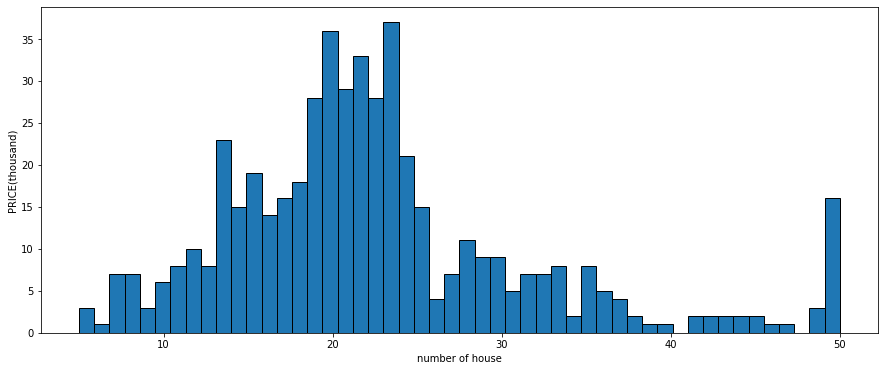

In [12]:
plt.figure(figsize=[15, 6])
plt.hist(df['PRICE(thousand)'], bins=50, ec='black')

plt.ylabel('PRICE(thousand)')
plt.xlabel('number of house')
plt.show()

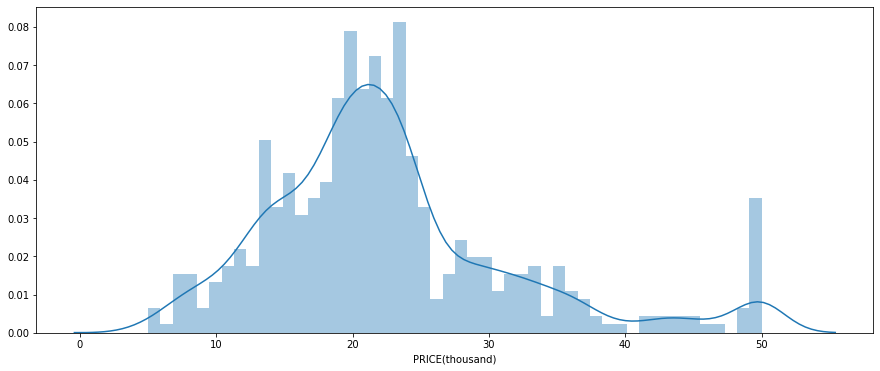

In [13]:
plt.figure(figsize=[15, 6])
sns.distplot(df['PRICE(thousand)'], bins=50, )  # get the PDF 
plt.show()

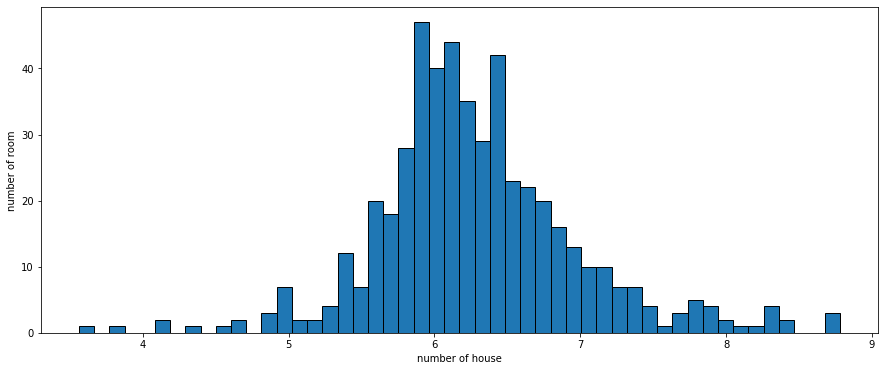

6.284634387351779
6.284634387351787


In [14]:
plt.figure(figsize=[15, 6])
plt.hist(df['RM'], bins=50, ec='black')

plt.ylabel('number of room')
plt.xlabel('number of house')
plt.show()

print(np.average(df['RM']))
print(df['RM'].mean())

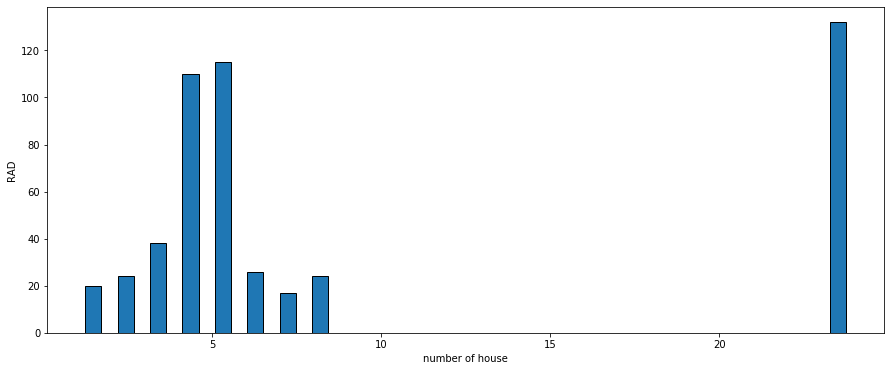

9.549407114624506
9.549407114624506


In [15]:
plt.figure(figsize=[15, 6])
plt.hist(df['RAD'], bins=24, ec='black', rwidth=0.5)

plt.ylabel('RAD')
plt.xlabel('number of house')
plt.show()

print(np.average(df['RAD']))
print(df['RAD'].mean())

In [16]:
df['RAD'].value_counts()  # go to description and see "index of acc to radial highways"
# RAD is RAD from 1 to 24

24.0    132
5.0     115
4.0     110
3.0      38
6.0      26
8.0      24
2.0      24
1.0      20
7.0      17
Name: RAD, dtype: int64

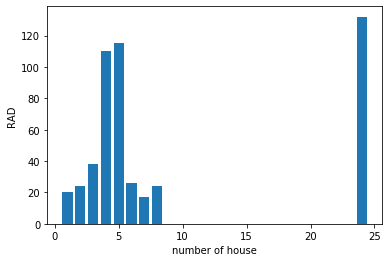

In [17]:
f = df['RAD'].value_counts()
# type(f)

# print(f.index)
# print(f.axes[0])

plt.bar(f.index, height=f)
plt.ylabel('RAD')
plt.xlabel('number of house')
plt.show()

In [18]:
# get the number of house near the river
df['CHAS'].value_counts()

0.0    471
1.0     35
Name: CHAS, dtype: int64

In [19]:
df.describe()

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,PRICE(thousand)
count,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000
mean,3.613524,11.363636,11.136779,0.069170,0.554695,6.284634,68.574901,3.795043,9.549407,408.237154,18.455534,356.674032,12.653063,22.532806
std,8.601545,23.322453,6.860353,0.253994,0.115878,0.702617,28.148861,2.105710,8.707259,168.537116,2.164946,91.294864,7.141062,9.197104
min,0.006320,0.000000,0.460000,0.000000,0.385000,3.561000,2.900000,1.129600,1.000000,187.000000,12.600000,0.320000,1.730000,5.000000
25%,0.082045,0.000000,5.190000,0.000000,0.449000,5.885500,45.025000,2.100175,4.000000,279.000000,17.400000,375.377500,6.950000,17.025000
50%,0.256510,0.000000,9.690000,0.000000,0.538000,6.208500,77.500000,3.207450,5.000000,330.000000,19.050000,391.440000,11.360000,21.200000
75%,3.677083,12.500000,18.100000,0.000000,0.624000,6.623500,94.075000,5.188425,24.000000,666.000000,20.200000,396.225000,16.955000,25.000000
max,88.976200,100.000000,27.740000,1.000000,0.871000,8.780000,100.000000,12.126500,24.000000,711.000000,22.000000,396.900000,37.970000,50.000000


## Correlation 

$$ \rho _{XY} = corr(X, Y)$$
$$ -1.0 \leq \rho _{XY} \leq +1.0 $$

In [20]:
df['PRICE(thousand)'].corr(df['RM'])
# the more room you have, the more space in your house, the more expensive house is


0.695359947071539

In [21]:
# ch: calculate the correlation between property prices and the pupil teacher ratio
df['PRICE(thousand)'].corr(df['PTRATIO'])
# imgine if the class is bigger >> pupil / teacher is greater >> lower quality >> low price house

-0.5077866855375615

In [22]:
# to calculate all correlation at the same time
df.corr() # pearson correlation coefficients

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,PRICE(thousand)
CRIM,1.000000,-0.200469,0.406583,-0.055892,0.420972,-0.219247,0.352734,-0.379670,0.625505,0.582764,0.289946,-0.385064,0.455621,-0.388305
ZN,-0.200469,1.000000,-0.533828,-0.042697,-0.516604,0.311991,-0.569537,0.664408,-0.311948,-0.314563,-0.391679,0.175520,-0.412995,0.360445
INDUS,0.406583,-0.533828,1.000000,0.062938,0.763651,-0.391676,0.644779,-0.708027,0.595129,0.720760,0.383248,-0.356977,0.603800,-0.483725
CHAS,-0.055892,-0.042697,0.062938,1.000000,0.091203,0.091251,0.086518,-0.099176,-0.007368,-0.035587,-0.121515,0.048788,-0.053929,0.175260
NOX,0.420972,-0.516604,0.763651,0.091203,1.000000,-0.302188,0.731470,-0.769230,0.611441,0.668023,0.188933,-0.380051,0.590879,-0.427321
RM,-0.219247,0.311991,-0.391676,0.091251,-0.302188,1.000000,-0.240265,0.205246,-0.209847,-0.292048,-0.355501,0.128069,-0.613808,0.695360
AGE,0.352734,-0.569537,0.644779,0.086518,0.731470,-0.240265,1.000000,-0.747881,0.456022,0.506456,0.261515,-0.273534,0.602339,-0.376955
DIS,-0.379670,0.664408,-0.708027,-0.099176,-0.769230,0.205246,-0.747881,1.000000,-0.494588,-0.534432,-0.232471,0.291512,-0.496996,0.249929
RAD,0.625505,-0.311948,0.595129,-0.007368,0.611441,-0.209847,0.456022,-0.494588,1.000000,0.910228,0.464741,-0.444413,0.488676,-0.381626
TAX,0.582764,-0.314563,0.720760,-0.035587,0.668023,-0.292048,0.506456,-0.534432,0.910228,1.000000,0.460853,-0.441808,0.543993,-0.468536


In [23]:
mask = np.zeros_like(df.corr())  # create zero array like any array from input
triangle_indices = np.triu_indices_from(mask)
mask[triangle_indices] = True
mask

array([[1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [0., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1.],
       [0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.]])

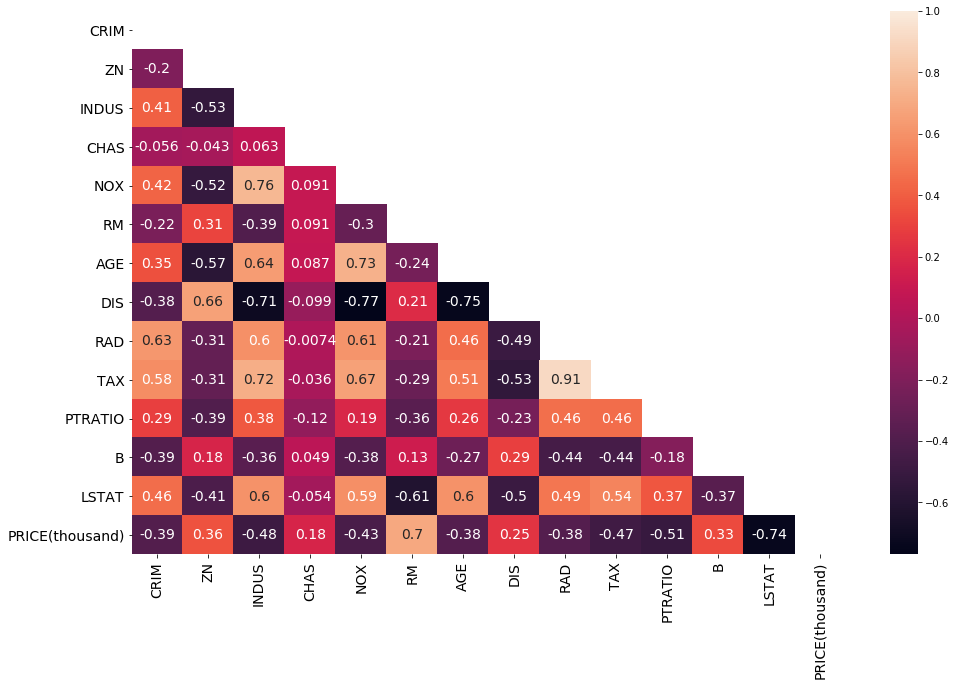

In [24]:
plt.figure(figsize=[16, 10])
sns.heatmap(df.corr(), mask=mask, annot=True, annot_kws={'size': 14})
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.show()

# strong correlation is white >> weak is black

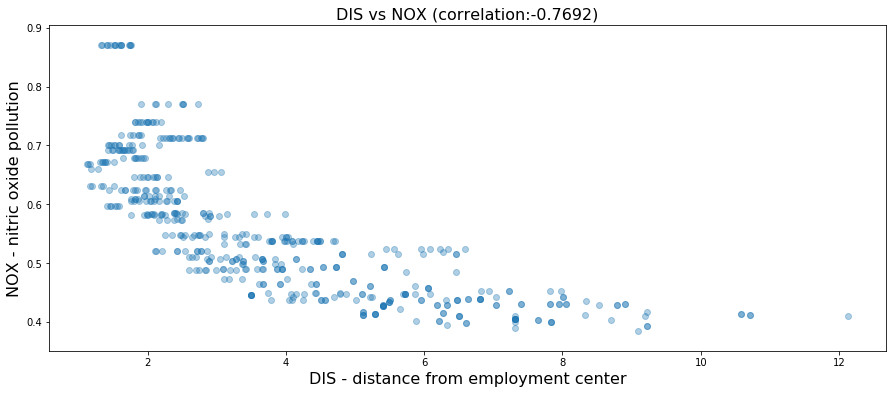

In [25]:
# challenge: picture the relationship between pollution and distance
corr = df['DIS'].corr(df['NOX'])  # the more distance, the less pollution
corr = corr.round(4)

plt.figure(figsize=[15,6])
plt.scatter(df['DIS'], df['NOX'], alpha=0.35)

plt.title(f'DIS vs NOX (correlation:{corr})', fontsize=16)
plt.xlabel('DIS - distance from employment center', fontsize=16)
plt.ylabel('NOX - nitric oxide pollution', fontsize=16)
plt.show()

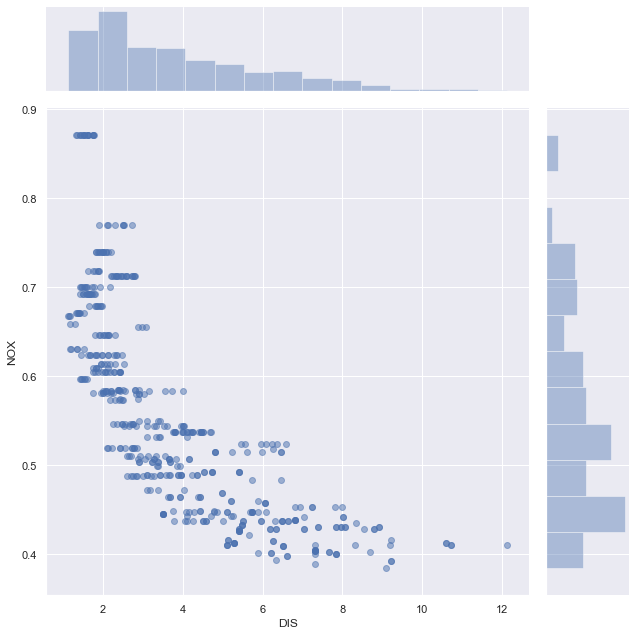

In [26]:
sns.set()  # reet style of the chart to default
sns.set_style('darkgrid')  # set the template style for the chart

sns.jointplot(x=df['DIS'], y=df['NOX'], size=9, joint_kws={'alpha': 0.5})  # seaborn scatter plot
plt.show()

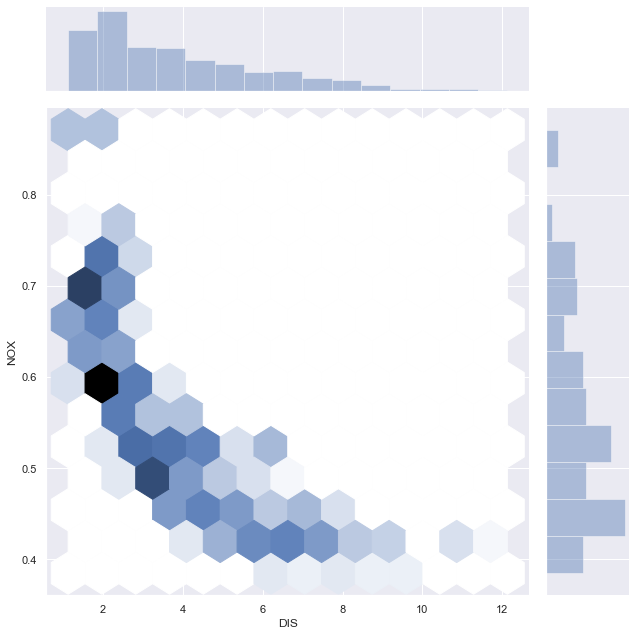

In [27]:
sns.set()  # reet style of the chart to default
sns.set_style('darkgrid')  # set the template style for the chart

sns.jointplot(x=df['DIS'], y=df['NOX'], kind='hex', size=9)  # seaborn scatter plot
plt.show()

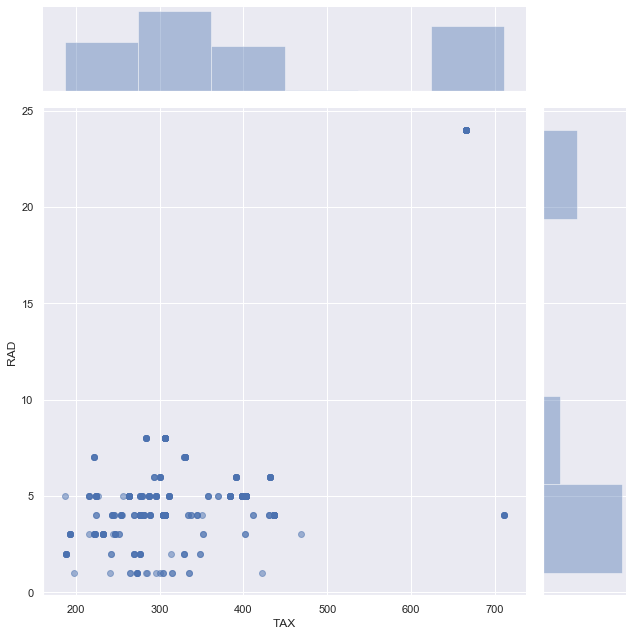

In [28]:
sns.set()  # reet style of the chart to default
sns.set_style('darkgrid')  # set the template style for the chart

sns.jointplot(x=df['TAX'], y=df['RAD'], size=9, joint_kws={'alpha': 0.5})  # seaborn scatter plot
plt.show()

# this data is not contonuous

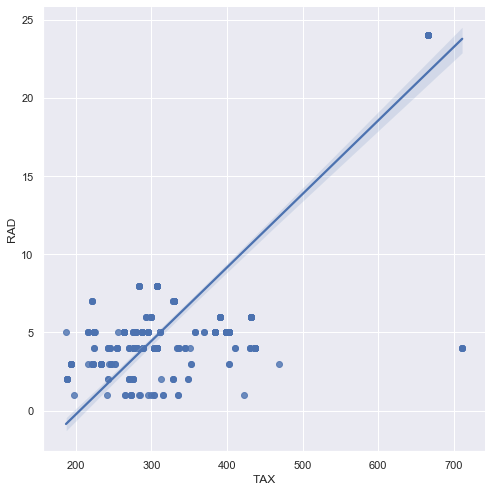

In [29]:
# use seaborn to plot linear regression
sns.lmplot(x='TAX', y='RAD', data=df, size=7)
plt.show()

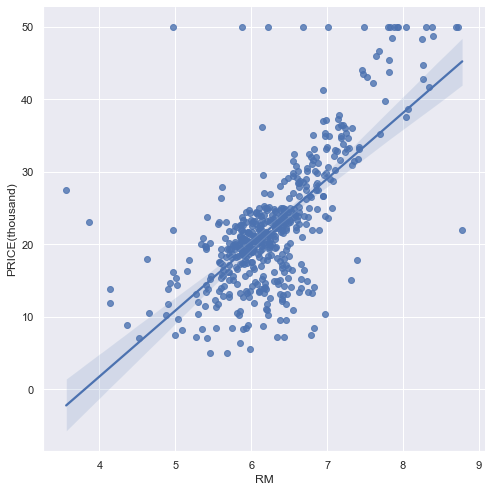

In [30]:
# plot regreesion on RM and PRICE
sns.lmplot(x='RM', y='PRICE(thousand)', data=df, size=7)
plt.show()

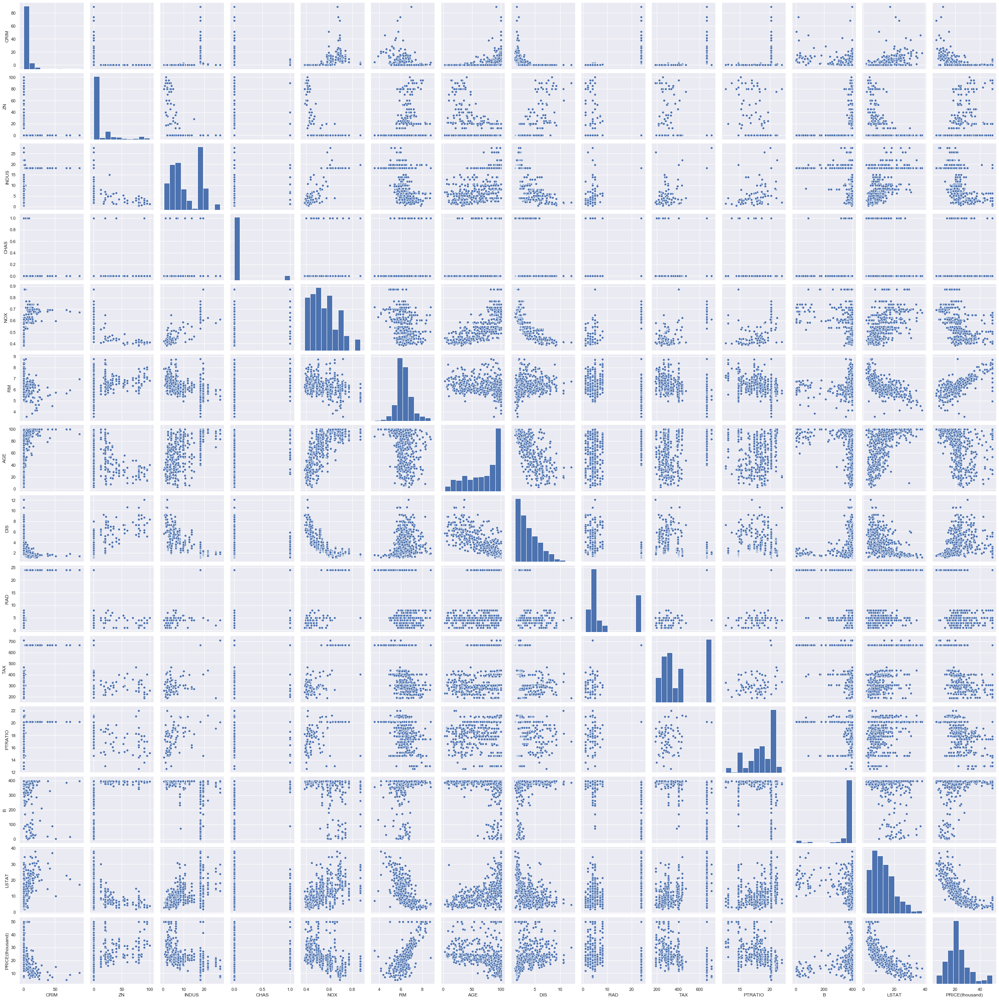

Wall time: 1min 9s


In [31]:
%%time

sns.pairplot(df)
plt.show()
# you can save image or zoom in to watch it more closely

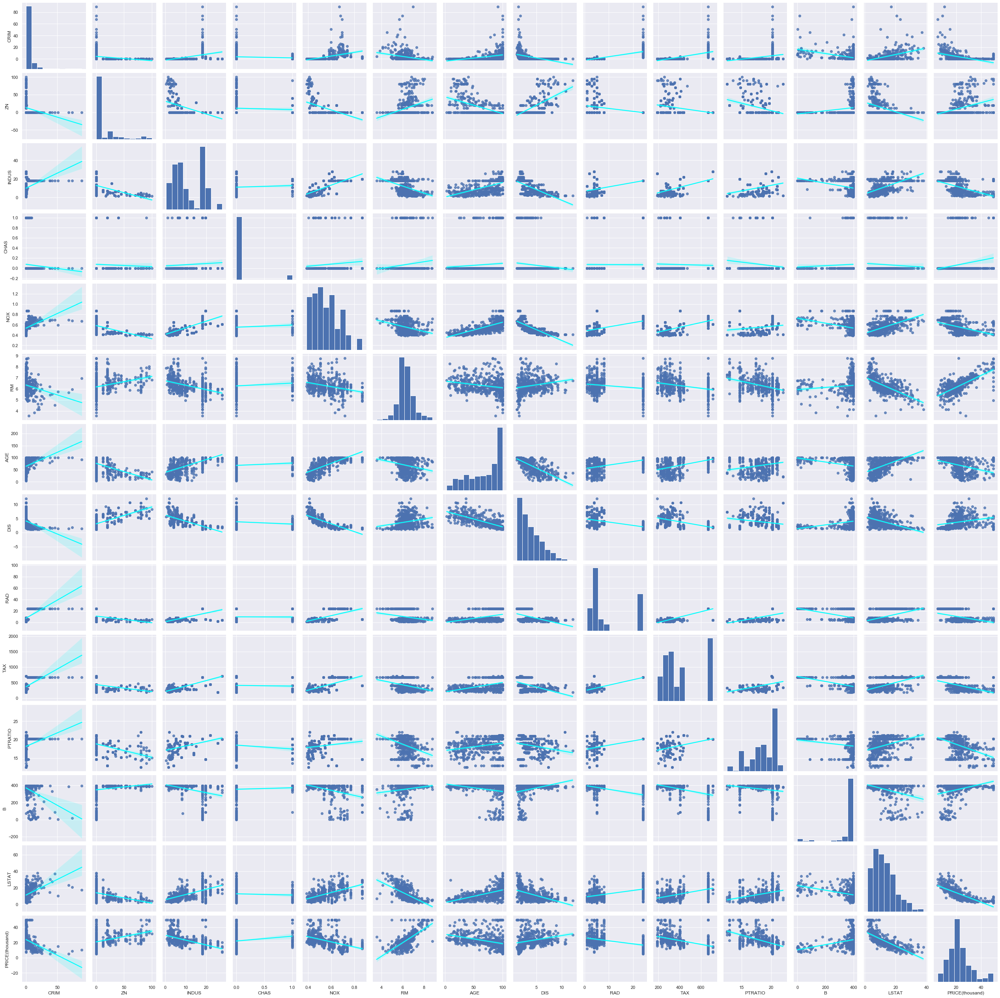

Wall time: 1min 43s


In [32]:
%%time
sns.pairplot(df, kind='reg', plot_kws={'line_kws': {'color': 'cyan'}})
plt.show()

## training & test dataset split

In [33]:
prices = df['PRICE(thousand)']
features = df.drop('PRICE(thousand)', axis=1)

X_train, X_test, y_train, t_test = train_test_split(features, prices, test_size=0.2, random_state=10)  # test data set would be 20% of size of dataset

In [37]:
reg = LinearRegression()
reg.fit(X_train, y_train)

print('intercept:', reg.intercept_)
pd.DataFrame(data=reg.coef_, index=X_train.columns, columns=['coef'])

intercept: 36.53305138282439


,coef
CRIM,-0.128181
ZN,0.063198
INDUS,-0.007576
CHAS,1.974515
NOX,-16.271989
RM,3.108456
AGE,0.016292
DIS,-1.483014
RAD,0.303988
TAX,-0.012082


In [ ]:
# let's look above and se if it make sense or not,
# the more NOX (pollution) the chaper price is >> make sense